In [42]:
import xarray as xr
import matplotlib.pyplot as plt
from netCDF4 import Dataset as netcdf
import pandas as pd
import cartopy as cart
import cartopy.feature as cfeature
import cartopy.crs as ccrs
import cartopy.mpl.ticker as cticker
from cartopy.util import add_cyclic_point
from cartopy.io.shapereader import Reader
from cartopy.feature import ShapelyFeature
from sklearn.linear_model import LinearRegression
import numpy as np
from shapely import geometry
import scipy.stats

In [11]:
monb = r'/WCMG/merged_data_ERA5/ERA5_daily/blh/monsoon/jjas_new.nc'
b = xr.open_dataset(monb)

In [12]:
b

<xarray.Dataset>
Dimensions:    (time: 6, bnds: 2, longitude: 141, latitude: 121)
Coordinates:
  * time       (time) datetime64[ns] 2010-07-31T23:30:00 ... 2015-07-31T23:30:00
  * longitude  (longitude) float32 65.0 65.25 65.5 65.75 ... 99.5 99.75 100.0
  * latitude   (latitude) float32 38.0 37.75 37.5 37.25 ... 8.75 8.5 8.25 8.0
Dimensions without coordinates: bnds
Data variables:
    time_bnds  (time, bnds) datetime64[ns] ...
    blh        (time, latitude, longitude) float64 ...
Attributes:
    CDI:          Climate Data Interface version ?? (http://mpimet.mpg.de/cdi)
    Conventions:  CF-1.6
    history:      Sun Dec 18 14:59:56 2022: cdo selyear,2010/2015 yearmean_jj...
    frequency:    year
    CDO:          Climate Data Operators version 1.9.3 (http://mpimet.mpg.de/...

In [13]:
x = b.blh
x

<xarray.DataArray 'blh' (time: 6, latitude: 121, longitude: 141)>
[102366 values with dtype=float64]
Coordinates:
  * time       (time) datetime64[ns] 2010-07-31T23:30:00 ... 2015-07-31T23:30:00
  * longitude  (longitude) float32 65.0 65.25 65.5 65.75 ... 99.5 99.75 100.0
  * latitude   (latitude) float32 38.0 37.75 37.5 37.25 ... 8.75 8.5 8.25 8.0
Attributes:
    long_name:  Boundary layer height
    units:      m

In [14]:
y = x.mean('time')
y

<xarray.DataArray 'blh' (latitude: 121, longitude: 141)>
array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])
Coordinates:
  * longitude  (longitude) float32 65.0 65.25 65.5 65.75 ... 99.5 99.75 100.0
  * latitude   (latitude) float32 38.0 37.75 37.5 37.25 ... 8.75 8.5 8.25 8.0

/home/user/anaconda3/lib/python3.8/site-packages/cartopy/mpl/geoaxes.py:1508: UserWarning: The following kwargs were not used by contour: 'transformation'
  result = matplotlib.axes.Axes.contourf(self, *args, **kwargs)


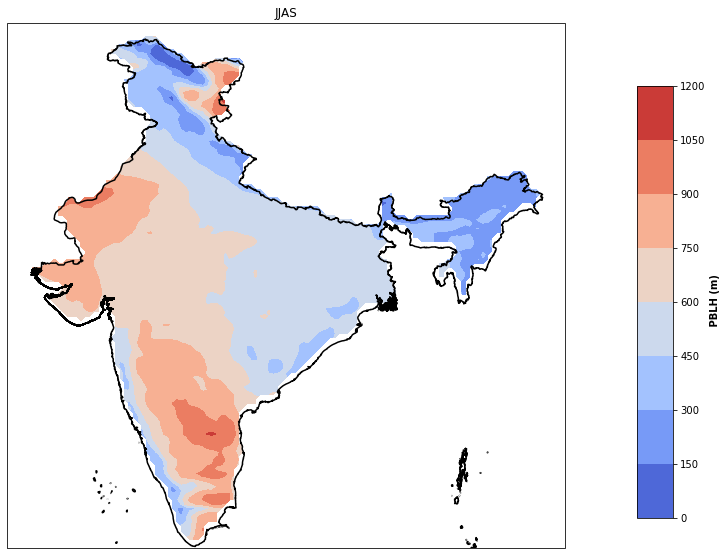

In [57]:
#SPATIAL PATTERN AT MEAN TIME
fig = plt.figure(figsize=(10,10))

#bounds=np.linspace(0,800,9)

ax1 = plt.subplot(1,1,1,projection = ccrs.PlateCarree())

plot1 = ax1.contourf(y.longitude,y.latitude,y, transformation = ccrs.PlateCarree(), cmap = 'coolwarm')
fname = '/WCMG/amitabha/MERRA2_1980_2020-20220408T182130Z-006/MERRA2_1980_2020/india_boundary/India_boundary.shp'
shape_feature = ShapelyFeature(Reader(fname).geometries(),
                               ccrs.PlateCarree(),facecolor='none', edgecolor='k',linewidths=1.5) 
ax1.add_feature(shape_feature)

plt.title('JJAS')

cax1= fig.add_axes([1, 0.18, 0.05, 0.6])
cax1.yaxis.set_tick_params(labelsize=10)
fig.colorbar(plot1, cax=cax1).set_label(label=' PBLH (m)',size=10,weight='bold')

In [37]:
nt, nlat, nlon = x.shape
ngrd = nlon*nlat

import scipy.stats as stats
sst_grd1  = np.reshape(x.values,(nt, ngrd))
x1        = np.arange(2010,2016) #.reshape((nt,1))
sst_rate1 = np.empty((ngrd,1))
sst_rate1[:,:] = np.nan

ppt_rate1 = np.empty((ngrd,1))
ppt_rate1[:,:] = np.nan

for i in range(ngrd): 
    y1 = sst_grd1[:,i]   
    if(not np.ma.is_masked(y1)):         
        
        slope, intercept, r_value, p_value, std_err = stats.linregress(x1, sst_grd1[:,i])
        sst_rate1[i,0] = slope
        ppt_rate1[i,0] = p_value
    
    
sst_rate1 = np.reshape(sst_rate1,(nlat,nlon))
ppt_rate1 = np.reshape(ppt_rate1,(nlat,nlon))    

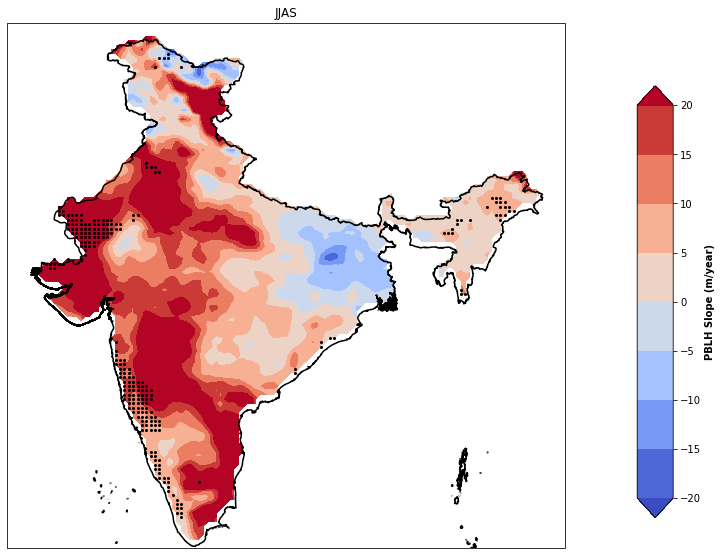

In [68]:
#SPATIAL TREND FOR EACH GRID POINT
fig = plt.figure(figsize = (10,10))

bounds=np.linspace(-20,20,9)

ax1 = plt.subplot(1,1,1, projection=ccrs.PlateCarree())

lats_win= x.latitude.values
lons_win = x.longitude.values
t = ppt_rate1 < 0.05
X,Y = np.meshgrid(lons_win,lats_win)

plot1 = ax1.contourf(x.longitude,x.latitude,sst_rate1,cmap = 'coolwarm', vmin = -20, vmax = 20, levels = bounds, extend = 'both')



for i in range(len(lats_win)):
    for j in range(len(lons_win)):
        xx, yy = X[i,j], Y[i,j]
        if t[i,j]:
            ax1.plot(xx, yy,'.', markersize=4, c='black')
            
fname = '/WCMG/amitabha/MERRA2_1980_2020-20220408T182130Z-006/MERRA2_1980_2020/india_boundary/India_boundary.shp'
shape_feature = ShapelyFeature(Reader(fname).geometries(),
                               ccrs.PlateCarree(),facecolor='none', edgecolor='k',linewidths=1.5) 
ax1.add_feature(shape_feature)
plt.title('JJAS')


cax1= fig.add_axes([1, 0.18, 0.05, 0.6])
cax1.yaxis.set_tick_params(labelsize=10)
fig.colorbar(plot1, cax=cax1).set_label(label='PBLH Slope (m/year)',size=10,weight='bold')

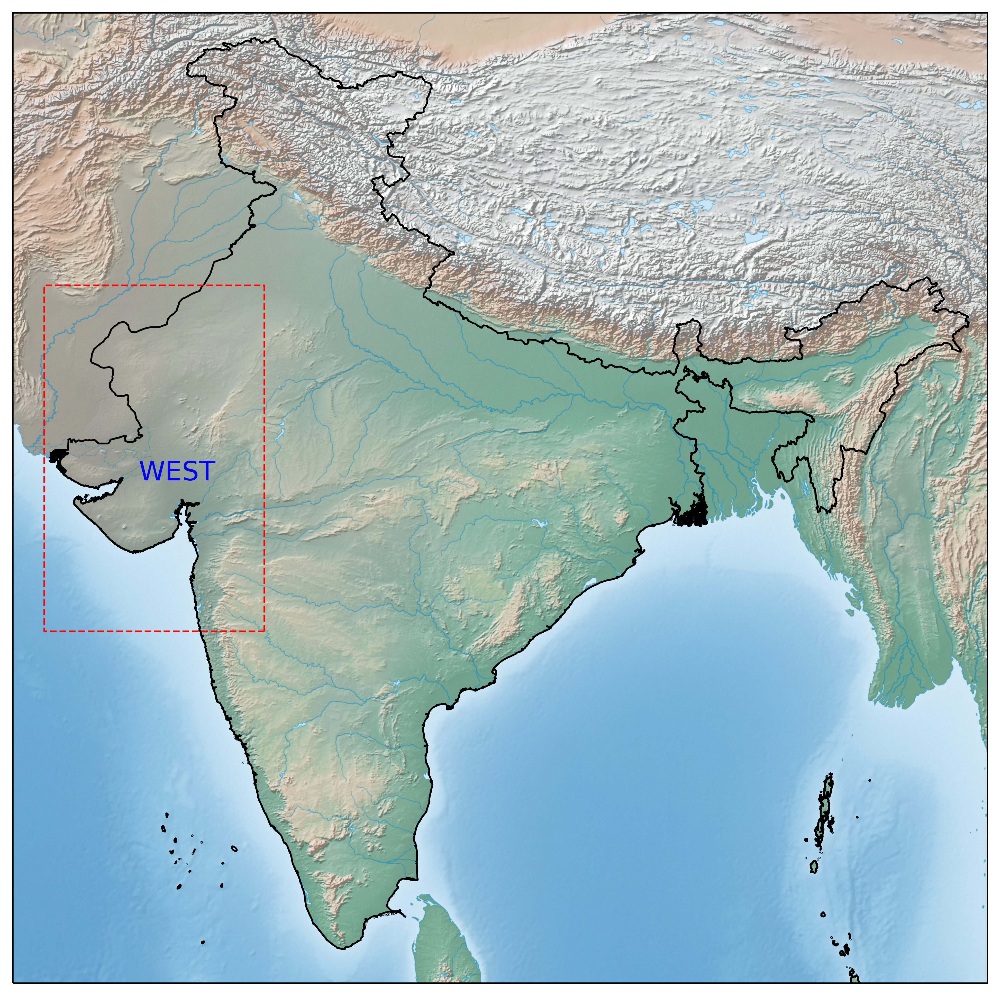

In [69]:
fname = '/WCMG/amitabha/MERRA2_1980_2020-20220408T182130Z-006/MERRA2_1980_2020/india_boundary/India_boundary.shp' 
shape_feature = ShapelyFeature(Reader(fname).geometries(),
                               ccrs.PlateCarree(),facecolor='none', edgecolor='k',linewidths=1)

import skimage.io as skio
imstack1    = skio.imread("/home/user/Downloads/HYP_HR_SR_OB_DR.tif", plugin="tifffile")


plt.figure(figsize=(10,10),dpi = 500)
ax = plt.axes(projection=ccrs.PlateCarree())


ax.imshow(imstack1, origin='upper', extent=[-180,180,-90,90], transform=ccrs.PlateCarree())
ax.add_feature(shape_feature)


geom_wir = geometry.box(minx=68,maxx=75,miny=18.2,maxy=29.2)
ax.add_geometries([geom_wir], crs=ccrs.PlateCarree(), alpha = 1, facecolor = 'none', edgecolor = 'red', linestyle = '--')


ax.text(71,23,'WEST', fontsize = 15, color = 'blue')


ax.set_ylabel('Latitude', weight = 'bold')
ax.set_xlabel('Longitude', weight = 'bold')

ax.set_extent([67,98,7,37])

plt.show()


In [41]:
z = x.mean(['longitude', 'latitude'])

jjas = {'Time': z.time, 'VC': z.data}
df = pd.DataFrame(jjas)
df['year'] = pd.DatetimeIndex(df['Time']).year
df

,Time,VC,year
0,2010-07-31 23:30:00,546.386648,2010
1,2011-07-31 23:30:00,568.538328,2011
2,2012-07-31 23:30:00,622.007551,2012
3,2013-07-31 23:30:00,557.465944,2013
4,2014-07-31 23:30:00,628.898509,2014
5,2015-07-31 23:30:00,599.299807,2015


In [43]:
result = scipy.stats.linregress(df['year'],df['VC'])
result

LinregressResult(slope=10.888706609715094, intercept=-21326.422587584744, rvalue=0.5883134517954266, pvalue=0.21934120609688418, stderr=7.483227821541986, intercept_stderr=15060.001413481126)

In [44]:
fit = df['year'] * result[0] + result[1]

Text(0, 0.5, 'PBLH (m)')

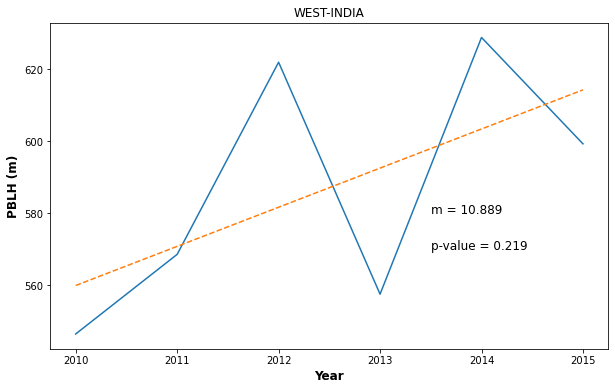

In [71]:
#AREA-AVERAGED TEMPORAL TREND AT WEST INDIA
plt.figure(figsize = (10,6))

ax1 = plt.subplot(1,1,1)
ax1.plot(df['year'],df['VC'])
ax1.plot(df['year'],fit, '--')

ax1.text(2013.5,580,'m = ' + '{:.3f}'.format(result[0]), size =12)
ax1.text(2013.5,570, 'p-value = ' + '{:.3f}'.format(result[3]),size =12)
ax1.title.set_text('WEST-INDIA')
ax1.set_xlabel('Year', size = 12, weight = 'bold')
ax1.set_ylabel('PBLH (m)', size = 12, weight = 'bold')